<a href="https://colab.research.google.com/github/Asuskf/Representa-tus-datos-usando-grafos-en-python/blob/master/Representa_tus_datos_usando_grafos_en_python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install Unidecode

     |████████████████████████████████| 245kB 5.3MB/s 


In [2]:
!wget https://gitlab.com/flisol_ecuador/datasw-ec/-/raw/master/data/estado/BDD-CP-software.csv?inline=false
!wget https://gitlab.com/flisol_ecuador/datasw-ec/-/raw/master/data/estado/gremios2.csv?inline=false

--2020-08-18 15:45:09--  https://gitlab.com/flisol_ecuador/datasw-ec/-/raw/master/data/estado/BDD-CP-software.csv?inline=false
Resolving gitlab.com (gitlab.com)... 172.65.251.78, 2606:4700:90:0:f22e:fbec:5bed:a9b9
Connecting to gitlab.com (gitlab.com)|172.65.251.78|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/plain]
Saving to: ‘BDD-CP-software.csv?inline=false’

BDD-CP-software.csv     [   <=>              ]   7.26M  16.3MB/s    in 0.4s    

2020-08-18 15:45:10 (16.3 MB/s) - ‘BDD-CP-software.csv?inline=false’ saved [7613422]

--2020-08-18 15:45:11--  https://gitlab.com/flisol_ecuador/datasw-ec/-/raw/master/data/estado/gremios2.csv?inline=false
Resolving gitlab.com (gitlab.com)... 172.65.251.78, 2606:4700:90:0:f22e:fbec:5bed:a9b9
Connecting to gitlab.com (gitlab.com)|172.65.251.78|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/plain]
Saving to: ‘gremios2.csv?inline=false’

gremios2.csv?inline    

In [107]:
import pandas as pd
import matplotlib.pyplot as plt
from unidecode import unidecode
from graphviz import Digraph
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
number_elements = 10

In [14]:
data = pd.read_csv('BDD-CP-software.csv?inline=false', delimiter=r";")

In [15]:
df_ruc = pd.read_csv('gremios2.csv?inline=false')

In [16]:
cl_ruc = {ruc.replace(' ','') :gremio  for ruc, gremio in df_ruc.to_dict().items()}

In [17]:
dict_gramios = pd.DataFrame(cl_ruc).set_index('ruc').to_dict()

In [71]:
df_data =  data[['Ruc_Proveedor','Razon_Social_Proveedor','Codigo_Proceso','Nombre_Entidad','Descripcion_compra', 'Provincia_Proveedor', 'Tipo_Contratacion', 'Presupuesto referencial']]

In [72]:
df_data.isnull().sum()

Ruc_Proveedor              135
Razon_Social_Proveedor      38
Codigo_Proceso               0
Nombre_Entidad              57
Descripcion_compra         259
Provincia_Proveedor          0
Tipo_Contratacion            0
Presupuesto referencial      0
dtype: int64

In [73]:
df_data = df_data[df_data['Ruc_Proveedor'].notna()]
df_data = df_data[df_data['Descripcion_compra'].notna()]

In [74]:
df_data.isnull().sum()

Ruc_Proveedor               0
Razon_Social_Proveedor      2
Codigo_Proceso              0
Nombre_Entidad             55
Descripcion_compra          0
Provincia_Proveedor         0
Tipo_Contratacion           0
Presupuesto referencial     0
dtype: int64

In [75]:
def find_words(text):
  text = text.replace('?','').replace('  ', ' ').replace('-', '')
  words = ['licencia', 'licencias', 'software', 'sistema', 'sistemas', 'programas', 'instalacion']
  text = [text if word in words else None for word in text.split(' ')]
  return text

In [76]:
df_data['Descripcion_compra'] = [find_words(unidecode(Descripcion_compra.lower())) for Descripcion_compra in df_data['Descripcion_compra'].to_list()]

In [77]:
df_data['Descripcion_compra'] = [''.join(list(filter(None, element))) for element in df_data['Descripcion_compra'].to_list()]

In [78]:
df_data = df_data.loc[df_data.loc[:, 'Descripcion_compra'] != '']

In [79]:
len_ruc = [ len(ruc) for ruc in df_data['Ruc_Proveedor'].to_list()]

In [80]:
df_data = df_data.assign(len_ruc = len_ruc) 

In [81]:
df_data = df_data.loc[df_data.loc[:, 'len_ruc'] >= 12]

In [82]:
def replace_ruc_Name(ruc):
  if ruc[0] == '0':
    ruc = ruc[1:]
  try:
    exist_ruc = dict_gramios['gremio'].get(int(ruc))
    if exist_ruc:
      gremio = exist_ruc
    else:
      gremio=ruc
  except:
      gremio = ruc
  return gremio

In [83]:
ruc_cl = [replace_ruc_Name(str(ruc).replace(' ','').replace('?','').replace('-','').replace('.','').replace('VARIOSPROVEEDO','')) for ruc in df_data['Ruc_Proveedor'].to_list()]

In [84]:
df_data['gremios'] = ruc_cl

In [85]:
def graf_result(values_counts, elements = 10, title_y = 'y', title_x ='x', graph_title='titulo'):
  df = pd.DataFrame(values_counts.to_dict().items())
  df = df.rename(columns={0: title_x, 1:title_y })
  df.head(elements).plot.barh(title=graph_title, x=0, rot=0)
  num_elements = df[title_y].sum()
  df['%'] = ((df[title_y]*100)/num_elements).round(2)
  return df.head(elements)


In [86]:
def amount_money(dataframe, name_colum = 'gremios', elements = 10):
  df_calculations = dataframe.loc[dataframe.loc[:, 'len_ruc'] >= 12 ]
  result = df_calculations.groupby([name_colum])['Presupuesto referencial'].sum().reset_index()
  total_budget = result['Presupuesto referencial'].sum()
  result['%_presupuesto'] = ((result['Presupuesto referencial']*100)/total_budget).round(2)
  return result.sort_values('Presupuesto referencial',ascending=False).head(elements)

,Ruc proveedores,# Contratos,%
0,AESOFT,1364,20.27
1,991010866001,138,2.05
2,1790924491001,126,1.87
3,1791710614001,124,1.84
4,4RIOS,119,1.77
5,1790859177001,118,1.75
6,1791148800001,115,1.71
7,1790869571001,111,1.65
8,1791811852001,96,1.43
9,1790819507001,94,1.40


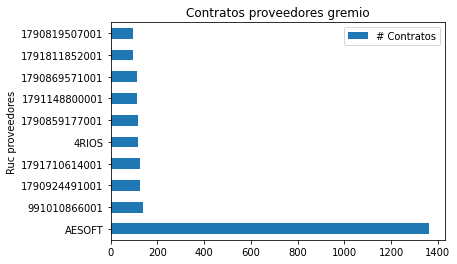

In [87]:
graf_result(pd.DataFrame(ruc_cl)[0].value_counts(), title_x="Ruc proveedores", title_y="# Contratos", graph_title="Contratos proveedores gremio")

In [88]:
amount_money(df_data, elements=number_elements)

,gremios,Presupuesto referencial,%_presupuesto
1319,AESOFT,1.748734e+08,19.26
4,100000000001068,1.420000e+08,15.64
390,1768007040001,9.088765e+07,10.01
1281,992686359001,4.320000e+07,4.76
1242,992508639001,3.145279e+07,3.46
1317,A29626009001,1.640600e+07,1.81
1120,991028544001,1.510931e+07,1.66
483,1791710614001,1.266079e+07,1.39
674,1792229162001,1.157621e+07,1.28
723,1792337755001,9.986579e+06,1.10


,Proveedores,# Contratos,%
0,GRUPO MICROSISTEMAS JOVICHSA S.A.,268,3.98
1,PROTELCOTELSA S.A.,190,2.82
2,NEXSYS DEL ECUADOR,165,2.45
3,TECNOLOGIA AVANZADA DEL ECUADOR TECNOAV C. LTDA.,135,2.01
4,EDICIONES LEGALES EDLE S.A.,126,1.87
5,INGENIERIA Y DESARROLLO DE SISTEMAS INDESIS CI...,124,1.84
6,LEGISLACION INDEXADA SISTEMATICA LEXIS S.A.,118,1.75
7,AKROS CIA. LTDA.,115,1.71
8,INGELSI CIA. LTDA.,111,1.65
9,COMPUTADORES Y EQUIPOS COMPUEQUIP DOS S.A.,103,1.53


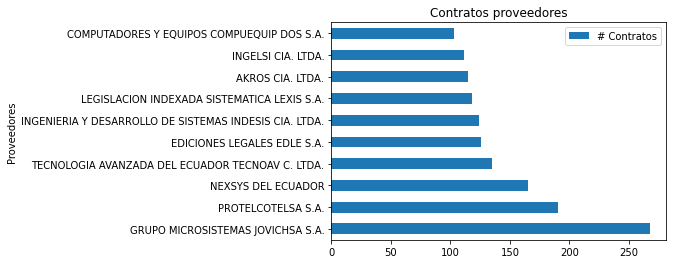

In [213]:
graf_result(df_data['Razon_Social_Proveedor'].value_counts(), title_x="Proveedores", title_y="# Contratos", graph_title="Contratos proveedores")

In [214]:
amount_money(df_data, name_colum='Razon_Social_Proveedor')

,Razon_Social_Proveedor,Presupuesto referencial,%_presupuesto
259,CHINA NATIONAL ELECTRONICS IMPORT & EXPORT COR...,1.420000e+08,15.64
360,CUERPO DE INGENIEROS DEL EJERCITO,9.088765e+07,10.01
717,KCINGLE CUPIA,4.320000e+07,4.76
877,NEXSYS DEL ECUADOR,3.688489e+07,4.06
615,IBM DEL ECUADOR C.A.,3.570652e+07,3.93
1140,SCHNEIDER ELECTRIC ESPAÑA S A,3.145279e+07,3.46
298,COMPUTADORES Y EQUIPOS COMPUEQUIP DOS S.A.,2.438382e+07,2.69
689,"ISOFT SANIDAD, S.A.",1.640600e+07,1.81
677,INTEROC S.A.,1.510931e+07,1.66
653,INGENIERIA Y DESARROLLO DE SISTEMAS INDESIS CI...,1.266079e+07,1.39


,Provincias,# Contratos,%
0,PICHINCHA,4776,70.98
1,GUAYAS,1065,15.83
2,NO DEFINIDO,241,3.58
3,AZUAY,241,3.58
4,MANABI,67,1.00
5,TUNGURAHUA,62,0.92
6,IMBABURA,44,0.65
7,CHIMBORAZO,41,0.61
8,LOJA,39,0.58
9,EL ORO,23,0.34


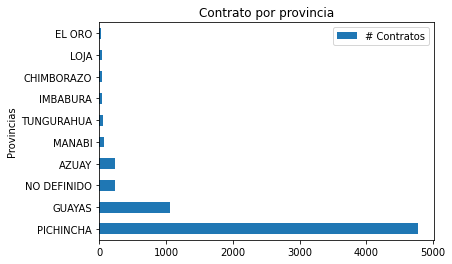

In [91]:
graf_result(df_data['Provincia_Proveedor'].value_counts(), title_x="Provincias", title_y="# Contratos", graph_title="Contrato por provincia")

In [92]:
amount_money(df_data, name_colum='Provincia_Proveedor')

,Provincia_Proveedor,Presupuesto referencial,%_presupuesto
19,PICHINCHA,5.077787e+08,55.93
16,NO DEFINIDO,2.474083e+08,27.25
8,GUAYAS,1.126600e+08,12.41
10,INTERNACIONAL,2.015478e+07,2.22
0,AZUAY,9.101240e+06,1.00
9,IMBABURA,2.078578e+06,0.23
13,MANABI,2.008712e+06,0.22
6,ESMERALDAS,1.264641e+06,0.14
23,TUNGURAHUA,1.095054e+06,0.12
11,LOJA,1.071563e+06,0.12


In [100]:
data_contracting = df_data.groupby(['Razon_Social_Proveedor','Nombre_Entidad']).first().reset_index()

In [127]:
def graph_results(dataframe, column = 'Razon_Social_Proveedor', second_column = 'Nombre_Entidad', elements = 10):
  major_suppliers = dataframe[column].value_counts().reset_index()
  list_major_suppliers = major_suppliers['index'].tolist()
  for suplier in list_major_suppliers[:elements]:
    df_suplier = dataframe[[column, second_column]].loc[dataframe[column] == suplier]
    business_name.append(df_suplier[column].to_list())
    entity.append(df_suplier[second_column].to_list())
  return pd.DataFrame(major_suppliers['index'].head(elements))


In [211]:
business_name = []
entity = []

df_result_ = graph_results(data_contracting)
business_name = [ element for value_list in business_name for element in value_list]
entity = [element for value_list in entity for element in value_list]
result_list = [tuple([b, e]) for b, e in zip(business_name, entity)]

/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 137 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 145 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 141 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 147 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 137 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.6/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 145 missing from current font.
  font.set_text(s, 0, fla

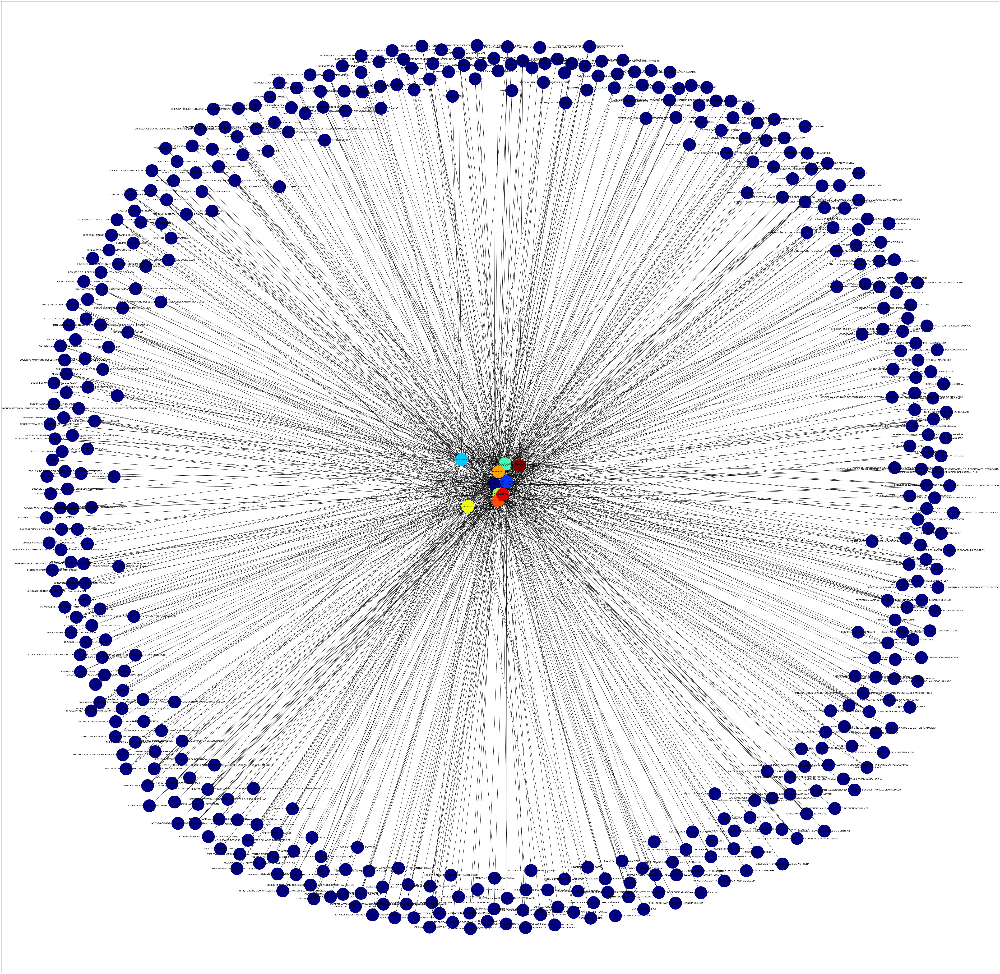

In [111]:
figure(num=None, figsize=(100, 100), dpi=80, facecolor='w', edgecolor='k')

G = nx.DiGraph()
G.add_edges_from(result_list)

val_map = {name : business_name.index(name)*2 for name in business_name}
values = [val_map.get(node, 0.25) for node in G.nodes()]
black_edges = [edge for edge in G.edges()]

pos = nx.spring_layout(G)
nx.draw_networkx_nodes(G, pos, cmap=plt.get_cmap('jet'), 
                       node_color = values, node_size = 5000)
nx.draw_networkx_labels(G, pos, font_color='black')
nx.draw_networkx_edges(G, pos, edgelist=black_edges, arrows=False)
plt.show()

In [152]:
df_result_['index'].tolist()

['GRUPO MICROSISTEMAS JOVICHSA S.A.',
 'PROTELCOTELSA S.A.',
 'EDICIONES LEGALES EDLE S.A.',
 'LEGISLACION INDEXADA SISTEMATICA LEXIS S.A.',
 'AKROS CIA. LTDA.',
 'INGENIERIA Y DESARROLLO DE SISTEMAS INDESIS CIA. LTDA.',
 'NEXSYS DEL ECUADOR',
 'INGELSI CIA. LTDA.',
 'COMPUTADORES Y EQUIPOS COMPUEQUIP DOS S.A.',
 'TECNOLOGIA AVANZADA DEL ECUADOR TECNOAV C. LTDA.']

In [217]:
amount_money(df_data, name_colum='Razon_Social_Proveedor')['Razon_Social_Proveedor'].tolist()

['CHINA NATIONAL ELECTRONICS IMPORT & EXPORT CORPORATION',
 'CUERPO DE INGENIEROS DEL EJERCITO',
 'KCINGLE CUPIA',
 'NEXSYS DEL ECUADOR',
 'IBM DEL ECUADOR C.A.',
 'SCHNEIDER ELECTRIC ESPAÑA S A',
 'COMPUTADORES Y EQUIPOS COMPUEQUIP DOS S.A.',
 'ISOFT SANIDAD, S.A.',
 'INTEROC S.A.',
 'INGENIERIA Y DESARROLLO DE SISTEMAS INDESIS CIA. LTDA.']

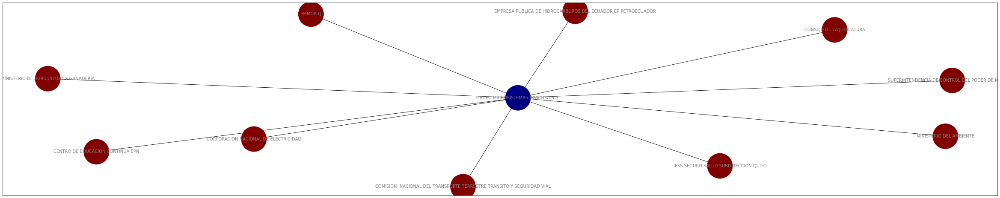

,Nombre_Entidad,Presupuesto referencial
77,IESS SEGURO SALUD SUBDIRECCION QUITO,300000.0000
15,CONSEJO DE LA JUDICATURA,250000.0000
53,EMPRESA PÚBLICA DE HIDROCARBUROS DEL ECUADOR E...,134391.0938
41,EMMOP-Q,72600.0000
23,CORPORACION NACIONAL DE ELECTRICIDAD,70000.0000
94,MINISTERIO DEL AMBIENTE,70000.0000
85,MINISTERIO DE AGRICULTURA Y GANADERÍA,64960.0000
9,COMISION NACIONAL DEL TRANSPORTE TERRESTRE TR...,51922.0000
5,CENTRO DE EDUCACION CONTINUA EPN,49979.0000
118,SUPERINTENDENCIA DE CONTROL DEL PODER DE MERCADO,46306.3100


In [222]:
#@title Razón social
elements_list = ['a', 'b']
Razon_Social_Proveedor = 'GRUPO MICROSISTEMAS JOVICHSA S.A.' #@param  ['GRUPO MICROSISTEMAS JOVICHSA S.A.',  'PROTELCOTELSA S.A.',  'EDICIONES LEGALES EDLE S.A.',  'LEGISLACION INDEXADA SISTEMATICA LEXIS S.A.',  'AKROS CIA. LTDA.',  'INGENIERIA Y DESARROLLO DE SISTEMAS INDESIS CIA. LTDA.',  'NEXSYS DEL ECUADOR',  'INGELSI CIA. LTDA.',  'COMPUTADORES Y EQUIPOS COMPUEQUIP DOS S.A.',  'TECNOLOGIA AVANZADA DEL ECUADOR TECNOAV C. LTDA.']

df_suplier = data_contracting[['Razon_Social_Proveedor', 'Nombre_Entidad','Presupuesto referencial']].loc[data_contracting['Razon_Social_Proveedor'] == Razon_Social_Proveedor]
df_suplier = df_suplier.groupby(['Nombre_Entidad','Razon_Social_Proveedor'])['Presupuesto referencial'].sum().reset_index().sort_values('Presupuesto referencial',ascending=False).head(number_elements)
list_suplier = df_suplier['Razon_Social_Proveedor'].to_list()
list_entity = df_suplier['Nombre_Entidad'].to_list()

tuple_result = [tuple([b, e]) for b, e in zip(list_suplier, list_entity)]

figure(num=None, figsize=(50, 10), dpi=60, facecolor='w', edgecolor='k')

G = nx.DiGraph()
G.add_edges_from(tuple_result)

val_map = {name : business_name.index(name)*2 for name in business_name}
values = [val_map.get(node, 0.25) for node in G.nodes()]
black_edges = [edge for edge in G.edges()]

pos = nx.spring_layout(G)
nx.draw_networkx_nodes(G, pos, cmap=plt.get_cmap('jet'), 
                       node_color = values, node_size = 5000)
nx.draw_networkx_labels(G, pos, font_color='gray')
nx.draw_networkx_edges(G, pos, edgelist=black_edges, arrows=False)
plt.show()
df_suplier[['Nombre_Entidad','Presupuesto referencial']]